# <center style='color:darkkhaki'> Create patches from a big image both `sequentially` and `randomly` </center>

## 1. Import required libraries

In [1]:
import patchify
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

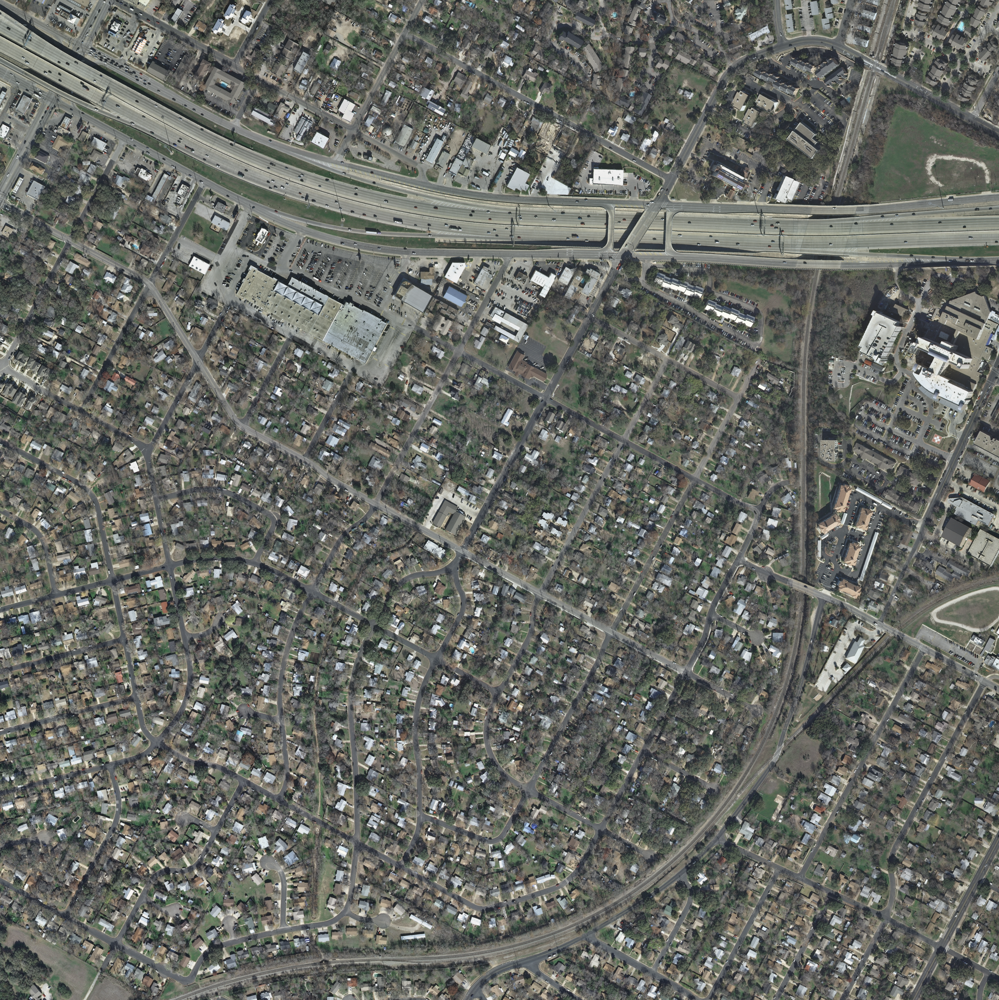

In [2]:
IMG = Image.open('/home/jadli/Bureau/BDAI2/Satellite_Super_Resulotion0/data/austin1.tif')
IMG

## 2. Check image size

In [3]:
IMG.size # (width, height)

(2999, 3000)

In [4]:
IMG.width

2999

In [5]:
IMG.height

3000

## 3. Check file format

In [6]:
IMG.mode

'RGB'

## 4. Resize the image

In [46]:
# resized = IMG.resize((800, 400))
resized = IMG

In [39]:
resized.size

(800, 400)

In [40]:
type(resized)

PIL.Image.Image

## 5. Create patches `sequentially`

In [47]:
gather = []

patches = patchify.patchify(np.asarray(resized), patch_size=(100, 100, 3), step=100)

In [42]:
patches.shape

(4, 8, 1, 100, 100, 3)

In [48]:
for i in range(patches.shape[0]):
    for j in range(patches.shape[1]):
        get_patches = patches[i, j, 0, :, :, :]
        gather.append(get_patches)

In [49]:
len(gather)

870

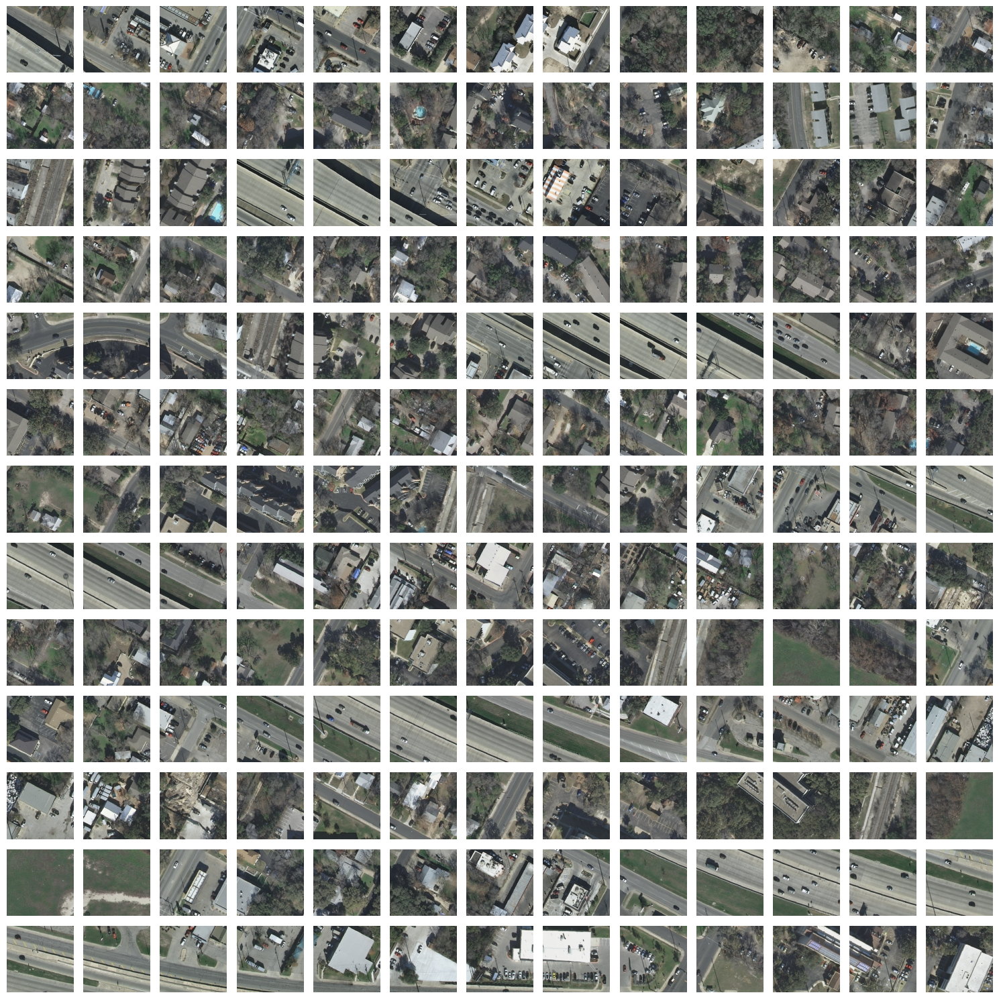

In [34]:
nrows, ncols = 13, 13
fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 15))

a = 0
for r in range(nrows):
    for c in range(ncols):
        ax[r, c].imshow(gather[a])   # gather doit contenir au moins 169 patches
        ax[r, c].axis("off")
        a += 1

plt.tight_layout()
plt.show()


In [74]:
import cv2
import numpy as np

# -------- PARAMÈTRES --------
image_path = "/home/jadli/Bureau/BDAI2/Satellite_Super_Resulotion0/data/austin1.tif"
n_patches = 13
gap = 5
output_path = "output_grid_13x13.png"
# ----------------------------


# Charger image
img = cv2.imread(image_path, cv2.IMREAD_COLOR)
if img is None:
    raise ValueError("Image non trouvée")

img = img.astype(np.uint8)

h, w, _ = img.shape
patch_h = h // n_patches
patch_w = w // n_patches

# Taille grille
grid_h = n_patches * patch_h + (n_patches + 1) * gap
grid_w = n_patches * patch_w + (n_patches + 1) * gap

# Fond blanc
grid = np.ones((grid_h, grid_w, 3), dtype=np.uint8) * 255

# Découpage + collage
for i in range(n_patches):
    for j in range(n_patches):
        patch = img[
            i*patch_h:(i+1)*patch_h,
            j*patch_w:(j+1)*patch_w
        ]

        gy = gap + i * (patch_h + gap)
        gx = gap + j * (patch_w + gap)

        grid[gy:gy+patch_h, gx:gx+patch_w] = patch

# 🔥 SAUVEGARDE PIL (PAS OpenCV)
Image.fromarray(grid).save(output_path)

print("✔ Image grille 13×13 générée avec succès")

✔ Image grille 13×13 générée avec succès
